# Correlation between Air Pollutions and Mortality

## Air Pollutions Data

In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import sklearn

### Data set: https://ec.europa.eu/eurostat/databrowser/view/env_ac_ainah_r2/default/table?lang=en

In [2]:
# DataFrame from Air Pollution CSV
ap_df = pd.read_csv("env_ac_ainah_r2_linear.csv", delimiter=",")
print('First Year:', min(ap_df['TIME_PERIOD']))
ap_df

First Year: 1995


,DATAFLOW,LAST UPDATE,freq,airpol,nace_r2,unit,geo,TIME_PERIOD,OBS_VALUE,OBS_FLAG
0,ESTAT:ENV_AC_AINAH_R2(1.0),20/12/22 23:00:00,A,ACG,A,G_HAB,AT,2008,14963.17,NaN
1,ESTAT:ENV_AC_AINAH_R2(1.0),20/12/22 23:00:00,A,ACG,A,G_HAB,AT,2009,15237.88,NaN
2,ESTAT:ENV_AC_AINAH_R2(1.0),20/12/22 23:00:00,A,ACG,A,G_HAB,AT,2010,15094.47,NaN
3,ESTAT:ENV_AC_AINAH_R2(1.0),20/12/22 23:00:00,A,ACG,A,G_HAB,AT,2011,15009.84,NaN
4,ESTAT:ENV_AC_AINAH_R2(1.0),20/12/22 23:00:00,A,ACG,A,G_HAB,AT,2012,15025.33,NaN
...,...,...,...,...,...,...,...,...,...,...
4528971,ESTAT:ENV_AC_AINAH_R2(1.0),20/12/22 23:00:00,A,SOX_SO2E,U,THS_T,UK,2015,0.00,NaN
4528972,ESTAT:ENV_AC_AINAH_R2(1.0),20/12/22 23:00:00,A,SOX_SO2E,U,THS_T,UK,2016,0.00,NaN
4528973,ESTAT:ENV_AC_AINAH_R2(1.0),20/12/22 23:00:00,A,SOX_SO2E,U,THS_T,UK,2017,0.00,NaN
4528974,ESTAT:ENV_AC_AINAH_R2(1.0),20/12/22 23:00:00,A,SOX_SO2E,U,THS_T,UK,2018,0.00,NaN


In [3]:
ap_df = ap_df[['geo', 'TIME_PERIOD', 'airpol', 'unit', 'OBS_VALUE']]
ap_df

,geo,TIME_PERIOD,airpol,unit,OBS_VALUE
0,AT,2008,ACG,G_HAB,14963.17
1,AT,2009,ACG,G_HAB,15237.88
2,AT,2010,ACG,G_HAB,15094.47
3,AT,2011,ACG,G_HAB,15009.84
4,AT,2012,ACG,G_HAB,15025.33
...,...,...,...,...,...
4528971,UK,2015,SOX_SO2E,THS_T,0.00
4528972,UK,2016,SOX_SO2E,THS_T,0.00
4528973,UK,2017,SOX_SO2E,THS_T,0.00
4528974,UK,2018,SOX_SO2E,THS_T,0.00


### Removing duplicated data

In [4]:
ap_df = ap_df.drop_duplicates(['geo', 'TIME_PERIOD', 'airpol'])
ap_df.reset_index(inplace = True, drop = True)

### Removing missing values (Values contaning "Nan")

In [5]:
ap_df = ap_df.dropna()

In [6]:
ap_df

,geo,TIME_PERIOD,airpol,unit,OBS_VALUE
0,AT,2008,ACG,G_HAB,14963.17
1,AT,2009,ACG,G_HAB,15237.88
2,AT,2010,ACG,G_HAB,15094.47
3,AT,2011,ACG,G_HAB,15009.84
4,AT,2012,ACG,G_HAB,15025.33
...,...,...,...,...,...
14029,CH,1995,SOX_SO2E,G_HAB,1298.31
14030,CH,1996,SOX_SO2E,G_HAB,1230.23
14031,CH,1997,SOX_SO2E,G_HAB,1097.63
14032,CH,1998,SOX_SO2E,G_HAB,1054.01


### Units

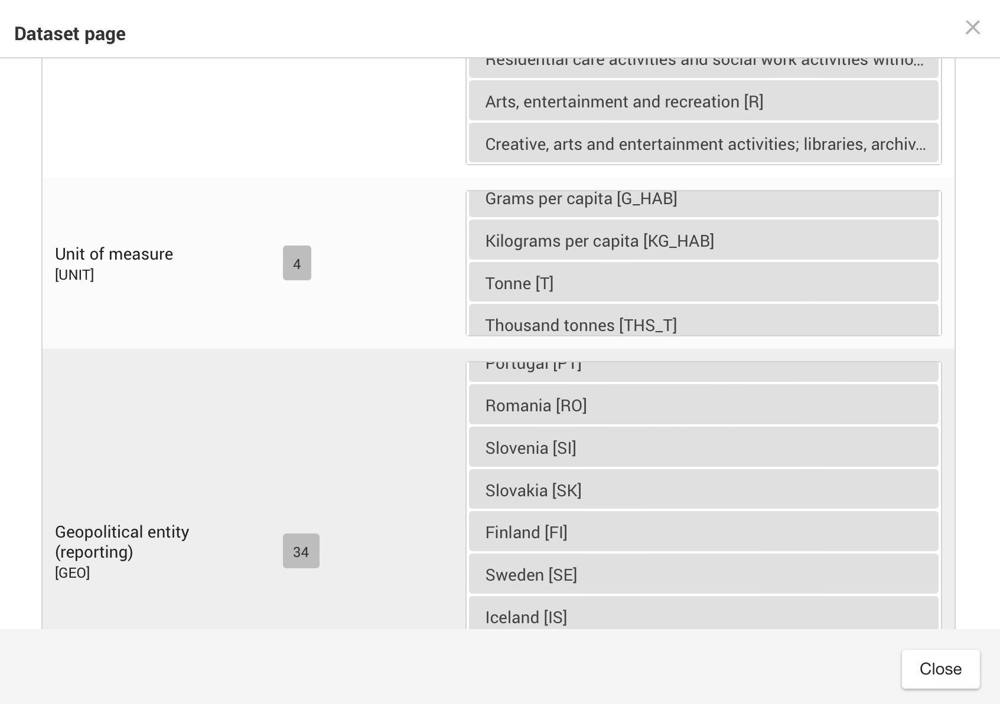

There is the need to standardize units, we need to decide rather we use per capita or quantitative measures

In [7]:
ap_df['unit'].value_counts()

G_HAB    14034
Name: unit, dtype: int64

ap_df = ap_df.drop(ap_df[ap_df.unit == 'G_HAB'].index)
ap_df = ap_df.drop(ap_df[ap_df.unit == 'KG_HAB'].index)

In [8]:
ap_df

,geo,TIME_PERIOD,airpol,unit,OBS_VALUE
0,AT,2008,ACG,G_HAB,14963.17
1,AT,2009,ACG,G_HAB,15237.88
2,AT,2010,ACG,G_HAB,15094.47
3,AT,2011,ACG,G_HAB,15009.84
4,AT,2012,ACG,G_HAB,15025.33
...,...,...,...,...,...
14029,CH,1995,SOX_SO2E,G_HAB,1298.31
14030,CH,1996,SOX_SO2E,G_HAB,1230.23
14031,CH,1997,SOX_SO2E,G_HAB,1097.63
14032,CH,1998,SOX_SO2E,G_HAB,1054.01


In [9]:
for i in range(len(ap_df.index)):
    if ap_df.iloc[i]['unit'] == 'THS_T':
        ap_df.iloc[i]['OBS_VALUE'] = ap_df.iloc[i]['OBS_VALUE']*1000

In [10]:
ap_df = ap_df.drop(['unit'], axis=1)
ap_df

,geo,TIME_PERIOD,airpol,OBS_VALUE
0,AT,2008,ACG,14963.17
1,AT,2009,ACG,15237.88
2,AT,2010,ACG,15094.47
3,AT,2011,ACG,15009.84
4,AT,2012,ACG,15025.33
...,...,...,...,...
14029,CH,1995,SOX_SO2E,1298.31
14030,CH,1996,SOX_SO2E,1230.23
14031,CH,1997,SOX_SO2E,1097.63
14032,CH,1998,SOX_SO2E,1054.01


### Plots of air polutions

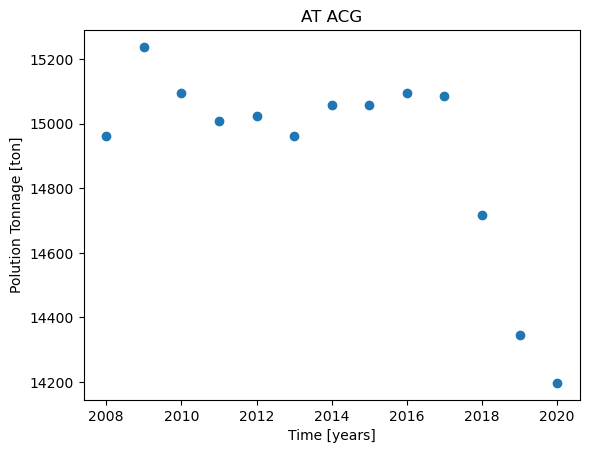

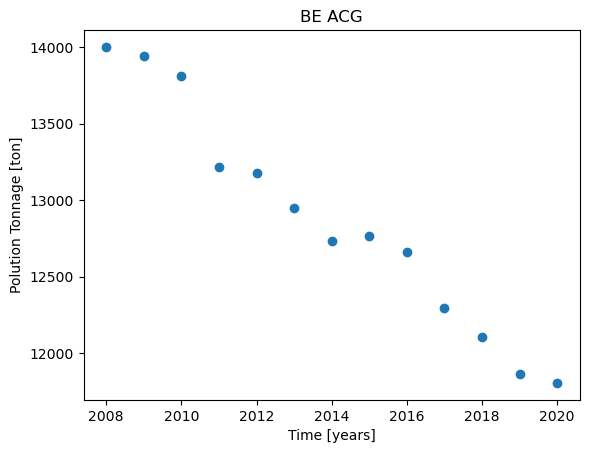

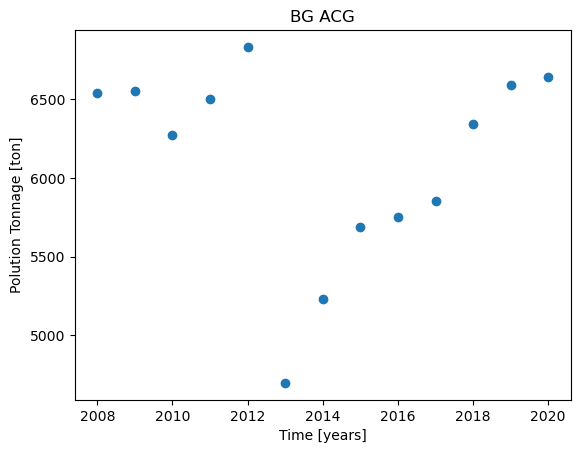

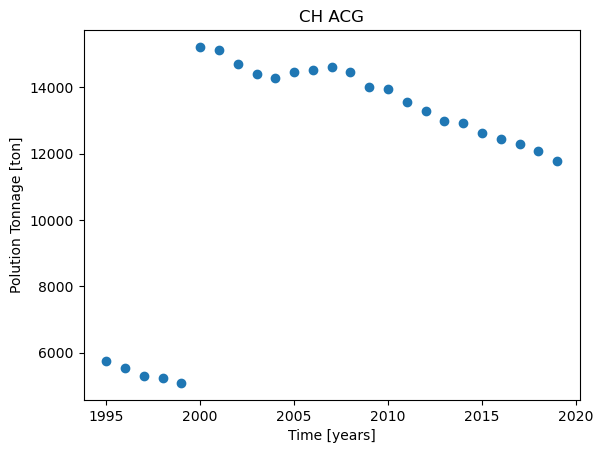

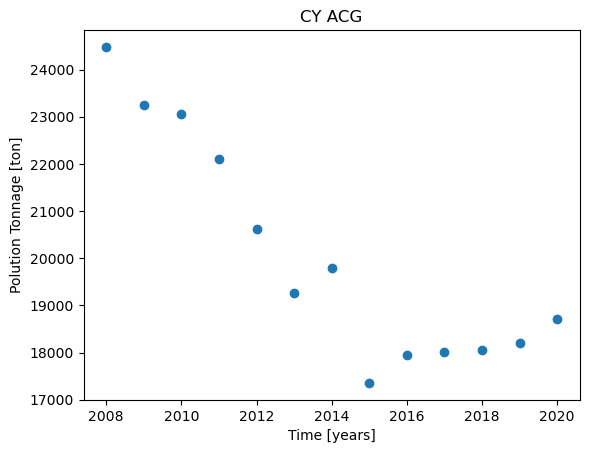

...

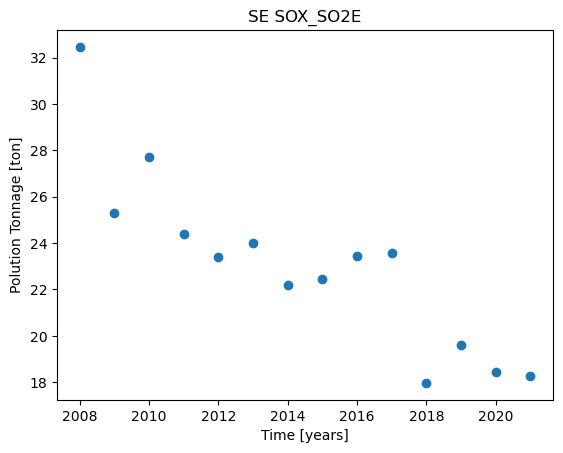

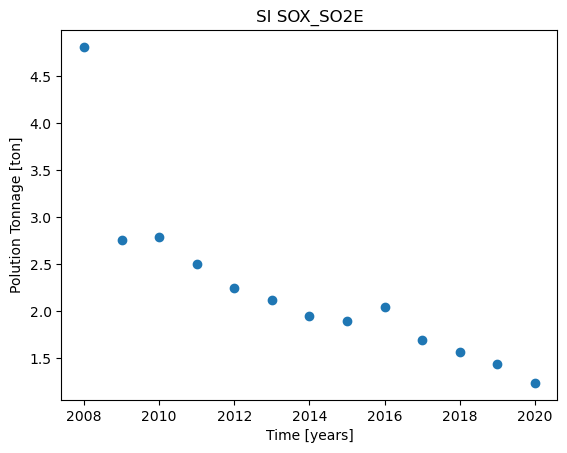

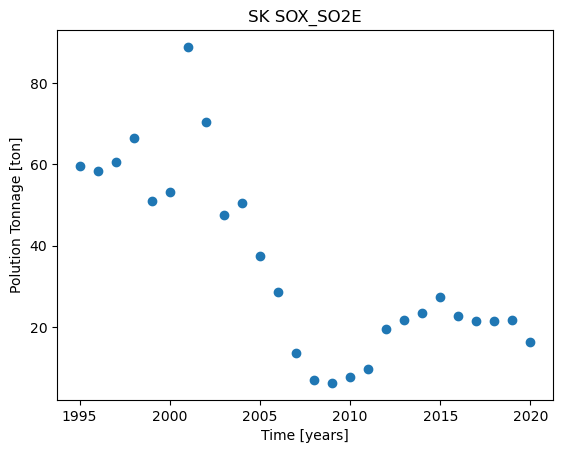

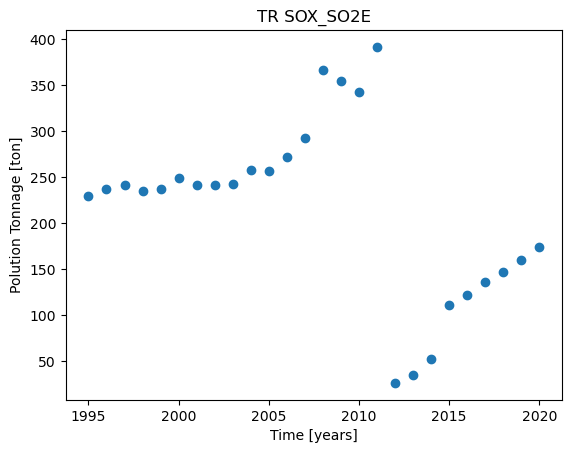

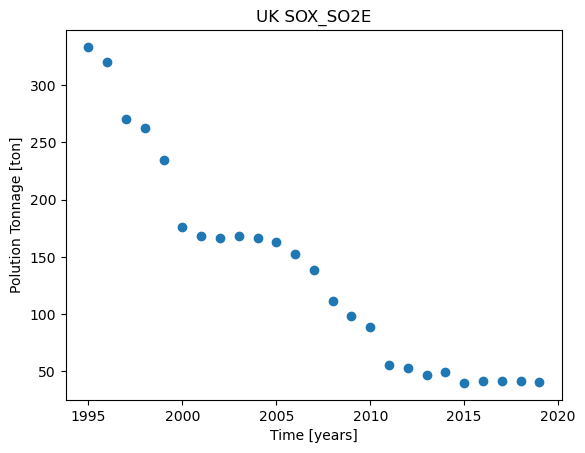

In [11]:
df = ap_df
for air in df['airpol'].unique():
    for geo in df['geo'].unique():
        dfl = df.loc[(df['geo']== geo) & (df['airpol']== air)]
        plt.title(geo+' '+air)
        plt.xlabel('Time [years]')
        plt.ylabel('Polution Tonnage [ton]')
        plt.scatter(dfl['TIME_PERIOD'], dfl['OBS_VALUE'])
        plt.show()

## Mortality Data

### Data set: https://ec.europa.eu/eurostat/databrowser/view/demo_mlexpec/default/table?lang=en

In [12]:
# DataFrame from AirPolution CSV
m_df = pd.read_csv("demo_mlexpec_linear.csv", delimiter=",")
m_df = m_df[['TIME_PERIOD', 'geo', 'sex', 'OBS_VALUE']]
print('First Year:', min(m_df['TIME_PERIOD']))
m_df = m_df[m_df['TIME_PERIOD'] > 1995]
m_df

First Year: 1960


,TIME_PERIOD,geo,sex,OBS_VALUE
0,2013,AL,F,79.6
1,2014,AL,F,79.8
2,2015,AL,F,79.2
3,2016,AL,F,79.8
4,2017,AL,F,79.7
...,...,...,...,...
474377,2015,UK,T,81.0
474378,2016,UK,T,81.2
474379,2017,UK,T,81.3
474380,2018,UK,T,81.3


In [13]:
m_df = m_df.drop_duplicates(['geo', 'TIME_PERIOD', 'sex'])
m_df = m_df.dropna()
m_df.reset_index(inplace = True, drop = True)

'T' in sex label stands for 'total' 

In [14]:
m_df = m_df.drop(m_df[m_df.sex != 'T'].index)
m_df

,TIME_PERIOD,geo,sex,OBS_VALUE
2310,2013,AL,T,77.6
2311,2014,AL,T,77.8
2312,2015,AL,T,77.5
2313,2016,AL,T,78.2
2314,2017,AL,T,78.1
...,...,...,...,...
3462,2021,PT,T,19.9
3463,2021,RO,T,14.7
3464,2021,SE,T,20.9
3465,2021,SI,T,19.4


In [15]:
m_df = m_df.drop_duplicates(['geo', 'TIME_PERIOD'])
m_df = m_df.dropna()
m_df.reset_index(inplace = True, drop = True)

# Air Polutions & Mortality

In this analyis we need input data which is a vector of air pollution values and output which is the mortality. That what we need to do is transform 'airpol' from rows to columns

### Test

In [16]:
ap_df

,geo,TIME_PERIOD,airpol,OBS_VALUE
0,AT,2008,ACG,14963.17
1,AT,2009,ACG,15237.88
2,AT,2010,ACG,15094.47
3,AT,2011,ACG,15009.84
4,AT,2012,ACG,15025.33
...,...,...,...,...
14029,CH,1995,SOX_SO2E,1298.31
14030,CH,1996,SOX_SO2E,1230.23
14031,CH,1997,SOX_SO2E,1097.63
14032,CH,1998,SOX_SO2E,1054.01


In [17]:
dfl = ap_df.loc[(ap_df['geo']== 'AT') & (ap_df['TIME_PERIOD'] == 2008)]
dfl

,geo,TIME_PERIOD,airpol,OBS_VALUE
0,AT,2008,ACG,14963.17
581,AT,2008,CH4,21171.88
1187,AT,2008,CH4_CO2E,529297.01
1793,AT,2008,CH4_NMVOCE,296.41
2399,AT,2008,CO,1728.01
2980,AT,2008,CO2,117564.28
3586,AT,2008,CO2_BIO,78124.06
4139,AT,2008,CO_NMVOCE,190.08
4720,AT,2008,GHG,960957.73
5281,AT,2008,HFC_CO2E,2130.79


In [18]:
df = pd.DataFrame()
df.at[1, 'geo'] = 'AT'
df.at[1, 'TIME_PERIOD'] = 2008
for i in range(len(dfl.index)):
    row = dfl.iloc[i]
    df[str(dfl.iloc[i]['airpol'])] = dfl.iloc[i]['OBS_VALUE']
df 

,geo,TIME_PERIOD,ACG,CH4,CH4_CO2E,CH4_NMVOCE,CO,CO2,CO2_BIO,CO_NMVOCE,...,NH3_SO2E,NMVOC,NOX,NOX_NMVOCE,NOX_SO2E,O3PR,PFC_CO2E,PM10,PM2_5,SOX_SO2E
1,AT,2008.0,14963.17,21171.88,529297.01,296.41,1728.01,117564.28,78124.06,190.08,...,13479.76,5184.41,2081.81,2539.81,1457.27,8210.7,0.0,590.99,124.01,26.14


### Data set with correct attributes (air pollution values)

In [19]:
df = pd.DataFrame()
j = 1 #row in new data set df
for geo in ap_df['geo'].unique():
    for time in ap_df['TIME_PERIOD'].unique():
        df.at[j, 'geo'] = geo
        df.at[j, 'TIME_PERIOD'] = int(time)
        dfl = ap_df.loc[(ap_df['geo']== geo) & (ap_df['TIME_PERIOD'] == int(time))]
        for i in range(len(dfl.index)):
            df.at[j, str(dfl.iloc[i]['airpol'])] = dfl.iloc[i]['OBS_VALUE']
        j = j + 1
df = df.dropna()
df.reset_index(inplace = True, drop = True)
df

,geo,TIME_PERIOD,ACG,CH4,CH4_CO2E,CH4_NMVOCE,CO,CO2,CO2_BIO,CO_NMVOCE,...,NH3_SO2E,NMVOC,NOX,NOX_NMVOCE,NOX_SO2E,O3PR,PFC_CO2E,PM10,PM2_5,SOX_SO2E
0,AT,2008.0,14963.17,21171.88,529297.01,296.41,1728.01,117564.28,78124.06,190.08,...,13479.76,5184.41,2081.81,2539.81,1457.27,8210.70,0.0,590.99,124.01,26.14
1,AT,2009.0,15237.88,21392.53,534813.13,299.50,1654.81,109878.48,79108.73,182.03,...,13811.99,5103.39,2013.03,2455.90,1409.12,8040.82,0.0,582.37,118.81,16.77
2,AT,2010.0,15094.47,21331.08,533276.92,298.64,1781.70,107796.54,88652.53,195.99,...,13761.83,5050.44,1879.95,2293.54,1315.97,7838.61,0.0,581.54,121.25,16.67
3,AT,2011.0,15009.84,21049.30,526232.49,294.69,1607.58,106927.93,85134.83,176.83,...,13650.16,4905.86,1922.05,2344.90,1345.43,7722.28,0.0,569.36,113.27,14.25
4,AT,2012.0,15025.33,20844.84,521120.88,291.83,1651.79,105228.35,91540.26,181.70,...,13673.81,4813.72,1909.54,2329.64,1336.68,7616.88,0.0,565.08,112.42,14.84
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
518,UK,1995.0,10808.18,20407.50,510187.57,285.71,893.29,147675.36,417.60,98.26,...,8704.72,3226.11,2528.70,3085.02,1770.09,6695.09,0.0,485.90,243.77,333.37
519,UK,1996.0,10953.00,20614.89,515372.13,288.61,856.38,149957.41,419.80,94.20,...,8868.42,3281.25,2520.96,3075.57,1764.67,6739.63,0.0,485.50,234.88,319.91
520,UK,1997.0,11022.55,20398.04,509951.05,285.57,850.90,134975.98,419.46,93.60,...,8994.12,3316.84,2510.92,3063.32,1757.64,6759.33,0.0,514.47,248.25,270.79
521,UK,1998.0,10827.59,20381.87,509546.69,285.35,803.40,139373.97,418.18,88.37,...,8831.42,3263.58,2476.18,3020.94,1733.33,6658.24,0.0,492.96,237.17,262.85


### Final Data set (contains air pollutions data and mortality in respect to country and year)

In [21]:
for i in range(len(df.index)):
    geo = df.iloc[i]['geo']
    time = df.iloc[i]['TIME_PERIOD']
    dfl = dfl = m_df.loc[(m_df['geo']== geo) & (m_df['TIME_PERIOD'] == int(time))]
    if dfl.empty == True:
        df.drop(i, axis=0)
        df.reset_index(inplace = True, drop = True)
    else:
        df.at[i, 'Life_Expectancy'] = dfl.OBS_VALUE

df = df.dropna()
y = df['Life_Expectancy']
df

,geo,TIME_PERIOD,ACG,CH4,CH4_CO2E,CH4_NMVOCE,CO,CO2,CO2_BIO,CO_NMVOCE,...,NMVOC,NOX,NOX_NMVOCE,NOX_SO2E,O3PR,PFC_CO2E,PM10,PM2_5,SOX_SO2E,Life_Expectancy
0,AT,2008.0,14963.17,21171.88,529297.01,296.41,1728.01,117564.28,78124.06,190.08,...,5184.41,2081.81,2539.81,1457.27,8210.70,0.0,590.99,124.01,26.14,79.9
1,AT,2009.0,15237.88,21392.53,534813.13,299.50,1654.81,109878.48,79108.73,182.03,...,5103.39,2013.03,2455.90,1409.12,8040.82,0.0,582.37,118.81,16.77,79.8
2,AT,2010.0,15094.47,21331.08,533276.92,298.64,1781.70,107796.54,88652.53,195.99,...,5050.44,1879.95,2293.54,1315.97,7838.61,0.0,581.54,121.25,16.67,80.1
3,AT,2011.0,15009.84,21049.30,526232.49,294.69,1607.58,106927.93,85134.83,176.83,...,4905.86,1922.05,2344.90,1345.43,7722.28,0.0,569.36,113.27,14.25,80.4
4,AT,2012.0,15025.33,20844.84,521120.88,291.83,1651.79,105228.35,91540.26,181.70,...,4813.72,1909.54,2329.64,1336.68,7616.88,0.0,565.08,112.42,14.84,80.3
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
517,UK,2007.0,8359.35,17027.86,425696.50,238.39,803.73,120686.69,648.39,88.41,...,2978.45,1463.48,1785.45,1024.44,5090.71,0.0,361.53,139.76,138.67,79.1
519,UK,1996.0,10953.00,20614.89,515372.13,288.61,856.38,149957.41,419.80,94.20,...,3281.25,2520.96,3075.57,1764.67,6739.63,0.0,485.50,234.88,319.91,76.4
520,UK,1997.0,11022.55,20398.04,509951.05,285.57,850.90,134975.98,419.46,93.60,...,3316.84,2510.92,3063.32,1757.64,6759.33,0.0,514.47,248.25,270.79,76.7
521,UK,1998.0,10827.59,20381.87,509546.69,285.35,803.40,139373.97,418.18,88.37,...,3263.58,2476.18,3020.94,1733.33,6658.24,0.0,492.96,237.17,262.85,76.8


# Analysis

In [22]:
y

0      79.9
1      79.8
2      80.1
3      80.4
4      80.3
       ... 
517    79.1
519    76.4
520    76.7
521    76.8
522    76.9
Name: Life_Expectancy, Length: 515, dtype: float64

In [23]:
X = df[df.columns[2:-1]]
X

,ACG,CH4,CH4_CO2E,CH4_NMVOCE,CO,CO2,CO2_BIO,CO_NMVOCE,GHG,HFC_CO2E,...,NH3_SO2E,NMVOC,NOX,NOX_NMVOCE,NOX_SO2E,O3PR,PFC_CO2E,PM10,PM2_5,SOX_SO2E
0,14963.17,21171.88,529297.01,296.41,1728.01,117564.28,78124.06,190.08,960957.73,2130.79,...,13479.76,5184.41,2081.81,2539.81,1457.27,8210.70,0.0,590.99,124.01,26.14
1,15237.88,21392.53,534813.13,299.50,1654.81,109878.48,79108.73,182.03,952527.26,2185.16,...,13811.99,5103.39,2013.03,2455.90,1409.12,8040.82,0.0,582.37,118.81,16.77
2,15094.47,21331.08,533276.92,298.64,1781.70,107796.54,88652.53,195.99,932717.81,2214.97,...,13761.83,5050.44,1879.95,2293.54,1315.97,7838.61,0.0,581.54,121.25,16.67
3,15009.84,21049.30,526232.49,294.69,1607.58,106927.93,85134.83,176.83,938688.68,2216.69,...,13650.16,4905.86,1922.05,2344.90,1345.43,7722.28,0.0,569.36,113.27,14.25
4,15025.33,20844.84,521120.88,291.83,1651.79,105228.35,91540.26,181.70,926452.71,2226.16,...,13673.81,4813.72,1909.54,2329.64,1336.68,7616.88,0.0,565.08,112.42,14.84
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
517,8359.35,17027.86,425696.50,238.39,803.73,120686.69,648.39,88.41,776678.07,487.80,...,7196.24,2978.45,1463.48,1785.45,1024.44,5090.71,0.0,361.53,139.76,138.67
519,10953.00,20614.89,515372.13,288.61,856.38,149957.41,419.80,94.20,958395.98,24.48,...,8868.42,3281.25,2520.96,3075.57,1764.67,6739.63,0.0,485.50,234.88,319.91
520,11022.55,20398.04,509951.05,285.57,850.90,134975.98,419.46,93.60,941162.24,49.36,...,8994.12,3316.84,2510.92,3063.32,1757.64,6759.33,0.0,514.47,248.25,270.79
521,10827.59,20381.87,509546.69,285.35,803.40,139373.97,418.18,88.37,939055.33,62.86,...,8831.42,3263.58,2476.18,3020.94,1733.33,6658.24,0.0,492.96,237.17,262.85


In [24]:
df.to_csv('Expectancy.csv')

In [ ]:
import tensorflow